# Feature selection with tree models

# Libraries

In [1]:
import warnings
warnings.filterwarnings("ignore")

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

from imblearn.pipeline import Pipeline as ImbPipeline

import optuna
from sklearn.tree import DecisionTreeClassifier

from settings import OVER, UNDER, FEAT_SEL_PRE
from constants import FEATURES
from functions import importance_experiment_decision_tree

from optuna.visualization import plot_optimization_history, plot_param_importances, plot_slice


# Data Loading

In [2]:
X_train = pd.read_parquet("../../../../data/interim/copper/X_train.parquet")
y_train = pd.read_parquet("../../../../data/interim/copper/y_train_cat.parquet")

bootstrap = lambda X, i: X.sample(X.shape[0], replace=True, random_state=i)

X_list = [bootstrap(X_train[FEATURES], i) for i in range(1, 101, 10)]
y_list = [y_train.loc[X.index] for X in X_list]

# Optimization Studies
Optimization of a decison tree model, random forest and xgboost over all the created features without any dimensional reduction. The best models are used verify what are the best features for modeling the IRR.

## Decision tree

In [3]:
study_decision_tree = optuna.load_study(
    study_name="decision_tree",
    storage='sqlite:///decision_tree.db',
)

optuna.visualization.plot_pareto_front(study_decision_tree, target_names=["mean ROC-AUC", "log std ROC-AUC"])

In [ ]:
decision_tree_df = study_decision_tree.trials_dataframe()
decision_tree_df["Média"] = decision_tree_df["values_0"]
decision_tree_df["Desvio Padrão"] = (10**decision_tree_df["values_1"])
decision_tree_df = decision_tree_df.query("state == 'COMPLETE'")

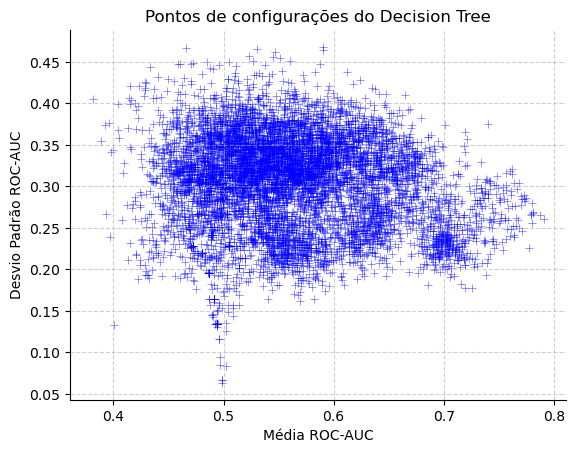

In [ ]:
ax = sns.scatterplot(
    decision_tree_df, 
    x = "Média", 
    y = "Desvio Padrão", 
    marker = "+", 
    alpha = 0.6, 
    color = "blue", 
    s=100
)

ax.set_title("Pontos de configurações do Decision Tree")
ax.set_xlabel("Média ROC-AUC")
ax.set_ylabel("Desvio Padrão ROC-AUC")
ax.grid(True, linestyle='--', alpha=0.6)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

## XGBoost

In [13]:
study_xgboost = optuna.load_study(
    study_name="xgboost",
    storage='sqlite:///xgboost.db'
)

optuna.visualization.plot_pareto_front(study_xgboost, target_names=["mean ROC-AUC", "log std ROC-AUC"])

In [14]:
decision_xgboost_df = study_xgboost.trials_dataframe()
decision_xgboost_df["Média"] = decision_xgboost_df["values_0"]
decision_xgboost_df["Desvio Padrão"] = (10**decision_xgboost_df["values_1"])
decision_xgboost_df = decision_xgboost_df.query("state == 'COMPLETE'")

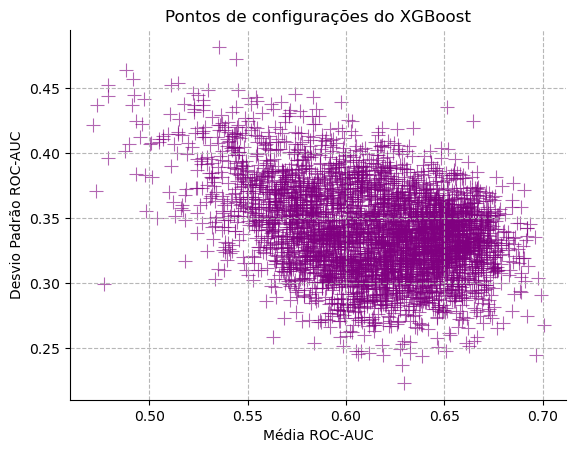

In [38]:
ax = sns.scatterplot(
    decision_xgboost_df, 
    x = "Média", 
    y = "Desvio Padrão", 
    marker = "+", 
    alpha = 0.6, 
    color = "purple", 
    s=100
)

ax.set_title("Pontos de configurações do XGBoost")
ax.set_xlabel("Média ROC-AUC")
ax.set_ylabel("Desvio Padrão ROC-AUC")
ax.grid(True, linestyle='--', alpha=0.9)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

## Random Forest 

In [22]:
study_random_forest = optuna.load_study(
    study_name="random_forest",
    storage='sqlite:///random_forest.db'
)

optuna.visualization.plot_pareto_front(study_random_forest, target_names=["mean ROC-AUC", "log std ROC-AUC"])

In [23]:
decision_random_forest_df = study_random_forest.trials_dataframe()
decision_random_forest_df["Média"] = decision_random_forest_df["values_0"]
decision_random_forest_df["Desvio Padrão"] = (10**decision_random_forest_df["values_1"])
decision_random_forest_df = decision_random_forest_df.query("state == 'COMPLETE'")

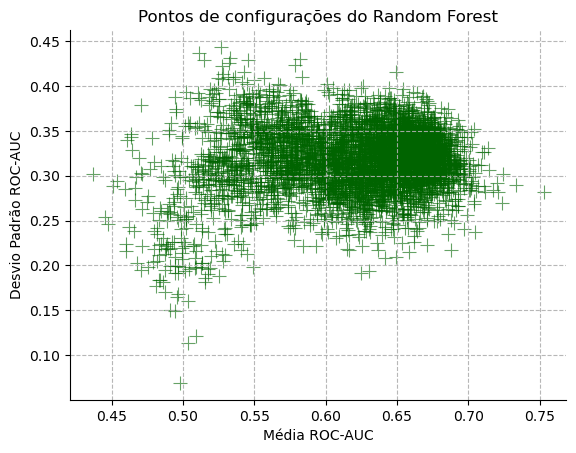

In [37]:
ax = sns.scatterplot(
    decision_random_forest_df, 
    x = "Média", 
    y = "Desvio Padrão", 
    marker = "+", 
    alpha = 0.6, 
    color = "darkgreen", 
    s=100
)

ax.set_title("Pontos de configurações do Random Forest")
ax.set_xlabel("Média ROC-AUC")
ax.set_ylabel("Desvio Padrão ROC-AUC")
ax.grid(True, linestyle='--', alpha=0.9)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Feature Selection

## Decision Tree

### Feature importance calculation

In [15]:
params = study_decision_tree.trials[4577].params

In [21]:
steps_list = [
    ('preprocessor', FEAT_SEL_PRE),
    ('over', OVER),
    ('under', UNDER),
    ('classifier', DecisionTreeClassifier(**params))]
    
aux_pipe = ImbPipeline(steps_list)

aux_pipe.fit(X_train, y_train)
NEW_FEATURES = aux_pipe[:-1].get_feature_names_out()
NEW_FEATURES = [col.split("__")[1] for col in NEW_FEATURES]

pipe = ImbPipeline(steps_list)

In [17]:
experiments = importance_experiment_decision_tree(X_list, y_list, pipe)

### Feature Importance Vizualization

In [18]:
exp_dfs = []

for exp in experiments:
    exp_dfs.append(pd.DataFrame([exp.tolist()], columns=NEW_FEATURES).reset_index())

exp_df = pd.concat(exp_dfs)
exp_df.reset_index(drop=True, inplace=True)


In [19]:
exp_median_df = exp_df.groupby("index").median()

plot_df = (
    exp_median_df.T
    .reset_index()
    .rename(columns={"index": "feature"})
    .melt(id_vars="feature", var_name="experiment", value_name="importance")
)

order = (
    plot_df
    .groupby("feature")["importance"]
    .mean()
    .sort_values(ascending = False).index
)

<Axes: xlabel='importance', ylabel='feature'>

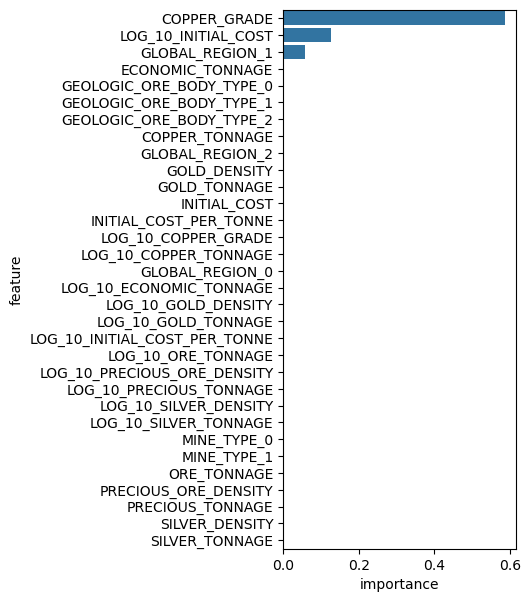

In [20]:
plt.figure(figsize=(3, 7))
sns.barplot(plot_df, y = "feature", x = "importance", orient="h", order=order)

## Random Forest

### Features importance calculation